In [1]:
import librosa
from ipywidgets import Audio
import IPython.display
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
import numpy as np
import scipy
import matplotlib.pyplot as plt
import soundfile as sf
import torch
from tqdm.notebook import tqdm
from functools import partial
from copy import deepcopy

from gfm_iaif import gfm_iaif
from utils import h1h2, weighted_log_mag_mse_loss, to_log_mag
from tract_proxy import VocalTractProxy
from optimize import TractControlsOptimizer

In [2]:
output_notebook()

Loading BokehJS ...

In [3]:
input, fs = librosa.load("C#2.wav")
Audio.from_file("C#2.wav", loop=False)

Audio(value=b'RIFF\n\xa5L\x00WAVEJUNK\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0…

In [4]:
framelength = 1024
hoplength = 128
fmin, fmax = 70, 500
ncilinders = 44

In [5]:
frames = librosa.util.frame(input, frame_length=framelength, hop_length=hoplength)
nframes = frames.shape[1]

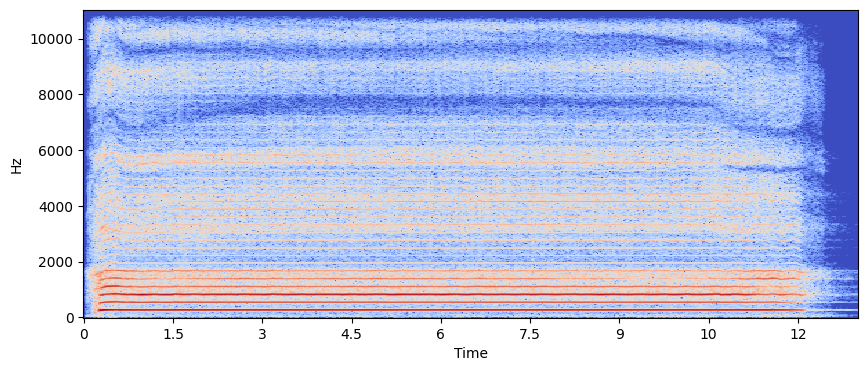

In [6]:
X = librosa.amplitude_to_db(np.abs(librosa.stft(input, n_fft=framelength))).squeeze()
plt.figure(figsize=(10,4))
librosa.display.specshow(X, sr=fs, x_axis="time", y_axis="hz")

## Analysis

### Pitch

- Yin
- `trough_threshold` defaults to $0.01$ but $0.1$ works better, or even $1$
- regions with with very low volume seem to work bad (chirp in result)

In [7]:
f0 = np.concatenate([librosa.yin(frames[:,i] / np.max(np.abs(frames[:,i])), fmin=fmin, fmax=fmax, frame_length=framelength, hop_length=hoplength, sr=fs, center=False, trough_threshold=0.1) for i in range(nframes)])
plot = figure(title="Estimated f0", x_axis_label="Frame", y_axis_label="Frequency (Hz)", width=800, height=400)
plot.line(np.arange(f0.size), f0)
show(plot)

When auto correlation is close to 0 (due to no signal, just noise), pitch goes crazy.

In [8]:
acorr = np.stack([np.max(librosa.autocorrelate(frames[:,i])) for i in range(nframes)])
plot = figure(title="Auto correlation", width=800, height=400, x_axis_label="Frame", y_axis_label="Correlation")
plot.line(np.arange(nframes), acorr)
show(plot)

### Inverse filtering with GFM-IAIF

In [9]:
glottis = np.zeros_like(input)
vtcoeffs = np.empty((ncilinders+1,nframes))
glcoeffs = np.empty((4, nframes))
lipcoeffs = np.empty((2, nframes))

for i in range(nframes):
    frame = frames[:, i]
    vtcoeffs[:,i], glcoeffs[:,i], lipcoeffs[:,i] = gfm_iaif(frame, n_vt=ncilinders)
    framepad = np.pad(frame, ((0,ncilinders+1)), mode='edge')
    idx = np.arange(librosa.frames_to_samples(i, hop_length=hoplength), librosa.frames_to_samples(i, hop_length=hoplength)+framelength)
    glottis[idx] += scipy.signal.lfilter(vtcoeffs[:,i], [1], framepad)[ncilinders+1:] * scipy.signal.get_window("hamming", framelength)

IPython.display.Audio(data=glottis.T.flatten(), rate=fs)

In [10]:
sf.write("glottis.wav", glottis, fs, subtype="PCM_16")

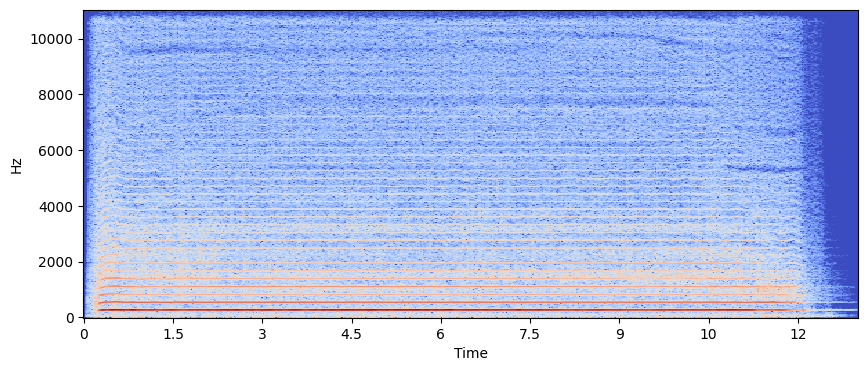

In [11]:
X = librosa.amplitude_to_db(np.abs(librosa.stft(glottis, n_fft=framelength))).squeeze()
plt.figure(figsize=(10,4))
librosa.display.specshow(X, sr=fs, x_axis="time", y_axis="hz")

In [12]:
plot = figure(title="Frequency response of vocal tract", width=800, height=400, x_axis_label="Frequency (Hz)", y_axis_label="Magnitude (dB)")
freqresp = np.empty((framelength//2, nframes), dtype=np.complex64)
for i in range(nframes):
    w, freqresp[:,i] = scipy.signal.freqz([1], vtcoeffs[:,i], plot=lambda w, h: plot.line(w, 20. * np.log10(np.abs(h)), alpha=0.05), fs=fs)
show(plot)

In [13]:
gframes = librosa.util.frame(glottis, frame_length=framelength, hop_length=hoplength)

### Tenseness

In [14]:
# Rd = torch.tensor((h1h2(gframes, f0, sr=fs) + 7.6) / 11.1)
Rd = np.empty(nframes)

for i in range(nframes):
    X = librosa.amplitude_to_db(np.abs(librosa.stft(gframes[:,i], n_fft=framelength, hop_length=framelength)))
    h1bin = int(np.round(f0[i] / fs * framelength))
    h2bin = int(np.round(2 * f0[i] / fs * framelength))
    Rd[i] = (X[h1bin,1] - X[h2bin,1] + 7.6) / 11.

plot = figure(title="Rd", width=800, height=400, x_axis_label="Frame")
plot.line(np.arange(nframes), Rd)
show(plot)

In [15]:
tenseness = np.clip(1 - Rd / 3, 0, 1)
plot = figure(title="Tenseness", width=800, height=400, x_axis_label="Frame")
plot.line(np.arange(nframes), tenseness)
show(plot)

## Curve fitting

In [17]:
plot = figure(title="Frequency Response of the Fitted Vocal Tract", width=800, height=400, x_axis_label="Frequency (Hz)", y_axis_label="Magnitude (dB)")
vt = VocalTractProxy(framelength // 2)
vtopt = TractControlsOptimizer(vt)
Hkl = np.empty((framelength // 2, nframes), dtype=np.complex64)

# for i in tqdm(range(nframes)):
for i in tqdm(range(nframes)):
    target = torch.tensor(freqresp[:,i], dtype=torch.complex64)

    # if i >= 400:
    #     with torch.autograd.detect_anomaly(check_nan=True):
    #         vtopt.optimize(target, loss_fn=partial(weighted_log_mag_mse_loss, sr=fs), n_iters=100, log_every_n_iters=20)
    # else:
    vtopt.optimize(target, loss_fn=partial(weighted_log_mag_mse_loss, sr=fs), n_iters=100, log_every_n_iters=20)


    print(f"frame {i}: tongue_idx={vtopt.params['tongue_idx'].get_raw()}, tongue_diam={vtopt.params['tongue_diam'].get_raw()}")

    # damp glottis-lips stationary wave
    vt.r0 = 0.1
    vt.rl = -0.85
    vt.tl = 1 + vt.rl

    # dampens nan unstabilities
    # TODO find out why they happen and fix them
    # if torch.isnan(vtopt.params["tongue_idx"].get_raw()).numpy().any():
    #     vtopt.params["tongue_idx"].get_raw().data[0] = vt.create_tongue_idx_param(init_val=0.5).get_raw()[0]
    # if torch.isnan(vtopt.params["tongue_diam"].get_raw()).numpy().any():
    #     vtopt.params["tongue_idx"].get_raw().data[:] = vt.create_tongue_diam_param(init_val=0.5).get_raw()[:]
    # if torch.isnan(vtopt.params["constrictions"].get_raw()).numpy().any():
    #     vtopt.params["constrictions"].get_raw().data[:] = vt.create_constrictions_param(init_val=0.5).get_raw()[:]

    Hkl[:,i] = vtopt.get_prediction().detach().numpy()

    if np.isnan(Hkl[:,i]).any():
        print(f"frame {i}: nan!!")
        break

    plot.line(np.linspace(0, fs // 2, Hkl[:,i].size), librosa.amplitude_to_db(np.abs(freqresp[:,i])), alpha=0.05, color="red")
    plot.line(np.linspace(0, fs // 2, Hkl[:,i].size), librosa.amplitude_to_db(np.abs(Hkl[:,i])), alpha=0.05)

show(plot)

  0%|          | 0/1114 [00:00<?, ?it/s]

Iter:    0, loss: 120.52
Iter:   20, loss: 78.49
Iter:   40, loss: 74.71
Iter:   60, loss: 60.37
Iter:   80, loss: 54.22
frame 0: tongue_idx=tensor([0.9348], requires_grad=True), tongue_diam=tensor([0.1500], requires_grad=True)
Iter:    0, loss: 66.34
Iter:   20, loss: 52.60
Iter:   40, loss: 48.58
Iter:   60, loss: 45.97
Iter:   80, loss: 44.12
frame 1: tongue_idx=tensor([1.], requires_grad=True), tongue_diam=tensor([0.2161], requires_grad=True)
Iter:    0, loss: 44.18
Iter:   20, loss: 40.28
Iter:   40, loss: 39.13
Iter:   60, loss: 38.59
Iter:   80, loss: 38.27
frame 2: tongue_idx=tensor([1.], requires_grad=True), tongue_diam=tensor([0.2204], requires_grad=True)
Iter:    0, loss: 40.20
Iter:   20, loss: 37.04
Iter:   40, loss: 36.53
Iter:   60, loss: 36.13
Iter:   80, loss: 35.79
frame 3: tongue_idx=tensor([1.], requires_grad=True), tongue_diam=tensor([0.1286], requires_grad=True)
Iter:    0, loss: 38.40
Iter:   20, loss: 36.39
Iter:   40, loss: 36.07
Iter:   60, loss: 35.85
Iter:  

In [ ]:
out = np.zeros_like(input)

for i in tqdm(range(nframes)):
    frame = gframes[:, i]
    framepad = np.pad(frame, ((0,ncilinders+1)), mode='edge')
    idx = np.arange(librosa.frames_to_samples(i, hop_length=hoplength), librosa.frames_to_samples(i, hop_length=hoplength)+framelength)
    out[idx] += np.fft.irfft(np.fft.rfft(frame * scipy.signal.get_window("hamming", framelength))[0:-1] * Hkl[:,i], n=framelength)

out = np.nan_to_num(out, nan=0.0)

IPython.display.Audio(data=out, rate=fs)

In [ ]:
sf.write("resynth-fixed.wav", out, fs, subtype="PCM_16")

## Tract contraction

In [ ]:
plot = figure(title="Frequency Response of the Fitted Vocal Tract", width=800, height=400, x_axis_label="Frequency (Hz)", y_axis_label="Magnitude (dB)")
vt = VocalTractProxy(framelength // 2, scale=4)
vtopt = TractControlsOptimizer(vt)
Hkl = np.empty((framelength // 2, nframes), dtype=np.complex64)

for i in tqdm(range(nframes)):
    target = torch.tensor(freqresp[:,i], dtype=torch.complex64)
    vtopt.optimize(target, loss_fn=partial(weighted_log_mag_mse_loss, sr=fs), n_iters=40)

    # damp glottis-lips stationary wave
    vt.r0 = 0.1
    vt.rl = -0.85
    vt.tl = 1 + vt.rl

    # diammod = scipy.signal.resample(vtopt.constricted_diam.detach().numpy(), ncilindersmod)
    # Hkl[:,i] = vt.freq_response(torch.from_numpy(diammod)).detach().numpy()

    Hkl[:,i] = vtopt.get_prediction().detach().numpy()
    plot.line(np.linspace(0, fs // 2, Hkl[:,i].size), librosa.amplitude_to_db(np.abs(freqresp[:,i])), alpha=0.05, color="red")
    plot.line(np.linspace(0, fs // 2, Hkl[:,i].size), librosa.amplitude_to_db(np.abs(Hkl[:,i])), alpha=0.05)

show(plot)

In [ ]:
out = np.zeros_like(input)

for i in tqdm(range(nframes)):
    frame = gframes[:, i]
    framepad = np.pad(frame, ((0,ncilinders+1)), mode='edge')
    idx = np.arange(librosa.frames_to_samples(i, hop_length=hoplength), librosa.frames_to_samples(i, hop_length=hoplength)+framelength)
    out[idx] += np.fft.irfft(np.fft.rfft(frame * scipy.signal.get_window("hamming", framelength))[0:-1] * Hkl[:,i], n=framelength)

out = np.nan_to_num(out, nan=0.0)

IPython.display.Audio(data=out, rate=fs)

In [ ]:
sf.write("resynth-exp.wav", out, fs, subtype="PCM_16")